In [1]:
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-wr818ctm
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-wr818ctm
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 2.0 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369540 sha256=8c045b2906f61b5aed9a935d013c50eb42569e8874bc415f0da8774e189f6ebe
  Stored in directory: /tmp/pip-ephem-wheel-cache-3zwkmuj_/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip
  Attempting uninstall: wcwidth
    Found existing installation: wcwidth 0.2.6
    Uninstalling wcwidth-0.2.6:
      Successfully uninstalled wcwidth-0.2.6



Top predictions:

    NormalVideos: 67.38%
   RoadAccidents: 8.75%
        Shooting: 3.74%
       Vandalism: 3.27%
           Arson: 2.82%
         Assault: 2.45%
        Stealing: 2.43%
           Abuse: 2.37%
        Burglary: 1.90%
       Explosion: 1.57%
        Fighting: 1.40%
         Robbery: 1.15%
          Arrest: 0.61%
     Shoplifting: 0.18%
True label: Abuse


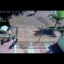

In [1]:
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
 
 
 
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)
 
 
 
 
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)
 
input_image_path = "/kaggle/input/ucf-crime-dataset/Test/Abuse/Abuse028_x264_0.png"
 
 
 
 
# Prepare the inputs
image = Image.open(input_image_path)
image_input = preprocess(image).unsqueeze(0).to(device)
 
text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)
 
# Calculate features
with torch.no_grad():
    image_features = model.encode_image(image_input)
    text_features = model.encode_text(text_inputs)
 
# Pick the top 5 most similar labels for the image
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
values, indices = similarity[0].topk(14)
 


# Print the result
print("\nTop predictions:\n")
for value, index in zip(values, indices):
    print(f"{classes[index]:>16s}: {100 * value.item():.2f}%")
print("True label:",input_image_path.split("/")[5])
image

In [2]:
!pip install --upgrade opencv-python

In [3]:
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given frame
def get_predictions(frame):
    # Prepare the inputs
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(14)

    # Return the top predictions
    return values, indices

# Function to process video stream or file
def process_video(input_source):
    cap = cv2.VideoCapture(input_source)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Get predictions for the current frame
        values, indices = get_predictions(frame)

        # Print the result
        print("\nTop predictions:\n")
        for value, index in zip(values, indices):
            print(f"{classes[index]:>16s}: {100 * value.item():.2f}%")

        # Show the current frame
        cv2.imshow('Frame', frame)

        # Break the loop if 'q' key is pressed
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

# Uncomment one of the following lines based on your preference:
# 1. For live camera stream
# process_video(0)

# 2. For a video file
# process_video('path/to/your/video/file.mp4')


In [ ]:
process_video('/kaggle/input/ucfcrimeminidataset/dataset/Abuse/Abuse018_x264.mp4')

In [1]:
import os
import clip
import torch
import cv2
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image

# Model and preprocessing
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Classes
folder_path = "/kaggle/input/ucf-crime-dataset/Test"  # Replace with your class folder path
classes = os.listdir(folder_path)
text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

# Capture video source (choose one)
cap = cv2.VideoCapture(0)  # For camera stream
# cap = cv2.VideoCapture("path/to/video.mp4")  # For video file

while True:
    ret, frame = cap.read()  # Read a frame

    # Preprocess frame
    preprocessed_frame = preprocess(frame).unsqueeze(0).to(device)

    # Get image features
    with torch.no_grad():
        image_features = model.encode_image(preprocessed_frame)

    # Calculate similarity scores
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(5)  # Get top 5 predictions

    # Display predictions
    print("\nTop predictions:\n")
    for value, index in zip(values, indices):
        print(f"{classes[index]:>16s}: {100 * value.item():.2f}%")

    # Optionally, display the frame with additional information
    cv2.imshow("Frame", frame)

    # Exit if 'q' is pressed
    if cv2.waitKey(1) == ord("q"):
        break

# Release resources
cap.release()
cv2.destroyAllWindows()


[ WARN:0@3.139] global cap_v4l.cpp:997 open VIDEOIO(V4L2:/dev/video0): can't open camera by index
[ERROR:0@3.140] global obsensor_uvc_stream_channel.cpp:159 getStreamChannelGroup Camera index out of range


TypeError: Unexpected type <class 'NoneType'>

In [1]:
!pip install git+https://github.com/openai/CLIP.git
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given image
def get_predictions_for_image(image_path):
    # Prepare the inputs
    image = Image.open(image_path)
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(14)

    # Return the top predictions
    return values, indices

# Function to process a single image
def process_image(image_path):
    # Get predictions for the image
    values, indices = get_predictions_for_image(image_path)

    # Print the result
    print("\nTop predictions:\n")
    for value, index in zip(values, indices):
        print(f"{classes[index]:>16s}: {100 * value.item():.2f}%")

# Specify the path to your image
image_path = "/kaggle/input/ucf-crime-dataset/Test/Abuse/Abuse028_x264_0.png"

# Process the image
process_image(image_path)


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-mtw_ccnf
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-mtw_ccnf
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done

Top predictions:

    NormalVideos: 67.38%
   RoadAccidents: 8.75%
        Shooting: 3.74%
       Vandalism: 3.27%
           Arson: 2.82%
         Assault: 2.45%
        Stealing: 2.43%
           Abuse: 2.37%
        Burglary: 1.90%
       Explosion: 1.57%
        Fighting: 1.40%
         Robbery: 1.15%
          Arrest: 0.61%
     Shoplifting: 0.18%


In [2]:
process_image('/kaggle/input/ucf-crime-dataset/Test/Burglary/Burglary005_x264_100.png')


Top predictions:

        Burglary: 75.42%
    NormalVideos: 12.74%
        Shooting: 3.69%
       Vandalism: 2.69%
        Stealing: 1.69%
   RoadAccidents: 0.84%
         Assault: 0.79%
         Robbery: 0.48%
       Explosion: 0.43%
           Arson: 0.39%
          Arrest: 0.33%
        Fighting: 0.28%
           Abuse: 0.20%
     Shoplifting: 0.02%


In [3]:
!pip install git+https://github.com/openai/CLIP.git
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given image
def get_predictions_for_image(image_path):
    # Prepare the inputs
    image = Image.open(image_path)
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(1)

    # Return the top prediction
    return values[0].item(), classes[indices[0]]

# Function to process a video
def process_video(video_path):
    cap = cv2.VideoCapture(video_path)

    frame_count = 0

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_count += 1

        # Skip frames until the 5th frame
        if frame_count % 5 != 0:
            continue

        # Get predictions for the current frame
        confidence, predicted_class = get_predictions_for_image(frame)

        # Print the result
        print(f"\nPrediction on frame {frame_count}:\n")
        print(f"Predicted class: {predicted_class}")
        print(f"Confidence: {confidence:.2f}%")

    cap.release()
    cv2.destroyAllWindows()

# Specify the path to your video file
video_path = '/kaggle/input/ucfcrimeminidataset/dataset/Burglary/Burglary059_x264.mp4'

# Process the video
process_video(video_path)


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-s6l9yi87
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-s6l9yi87
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done


AttributeError: 'numpy.ndarray' object has no attribute 'read'

In [4]:
!pip install git+https://github.com/openai/CLIP.git
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given image
def get_predictions_for_frame(frame):
    # Prepare the inputs
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(1)

    # Return the top prediction
    return values[0].item(), classes[indices[0]]

# Function to process a video
def process_video(video_path):
    cap = cv2.VideoCapture(video_path)

    frame_count = 0

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_count += 1

        # Skip frames until the 5th frame
        if frame_count % 5 != 0:
            continue

        # Get predictions for the current frame
        confidence, predicted_class = get_predictions_for_frame(frame)

        # Print the result
        print(f"\nPrediction on frame {frame_count}:\n")
        print(f"Predicted class: {predicted_class}")
        print(f"Confidence: {confidence:.2f}%")

    cap.release()
    cv2.destroyAllWindows()

# Specify the path to your video file
video_path = '/kaggle/input/ucfcrimeminidataset/dataset/Burglary/Burglary059_x264.mp4'

# Process the video
process_video(video_path)


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-qikgsj6n
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-qikgsj6n
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done

Prediction on frame 5:

Predicted class: Burglary
Confidence: 0.59%

Prediction on frame 10:

Predicted class: Burglary
Confidence: 0.60%

Prediction on frame 15:

Predicted class: Burglary
Confidence: 0.58%

Prediction on frame 20:

Predicted class: Burglary
Confidence: 0.60%

Prediction on frame 25:

Predicted class: Burglary
Confidence: 0.46%

Prediction on frame 30:

Predicted class: Burglary
Confidence: 0.53%

Prediction on frame 35:

Predicted class: Burglary
Confidence: 0.56%

Prediction on frame 40:

Predicted class: Burglary
Confidence: 0.63%

Prediction on frame 45:

Predicted class: Burglary
Confidence: 0.60%

Prediction on frame 50:

Predicted cla

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-ze3hgugw
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-ze3hgugw
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 2.0 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369540 sha256=cba3dac90ee072d452ee5b3d81af4586f9ac022096fe68709a3b897e413cf2b0
  Stored in directory: /tmp/pip-ephem-wheel-cache-7x3ar0fn/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip
  Attempting uninstall: wcwidth
    Found existing installation: wcwidth 0.2.6
    Uninstalling wcwidth-0.2.6:
      Successfully uninstalled wcwidth-0.2.6


100%|███████████████████████████████████████| 338M/338M [00:20<00:00, 17.1MiB/s]


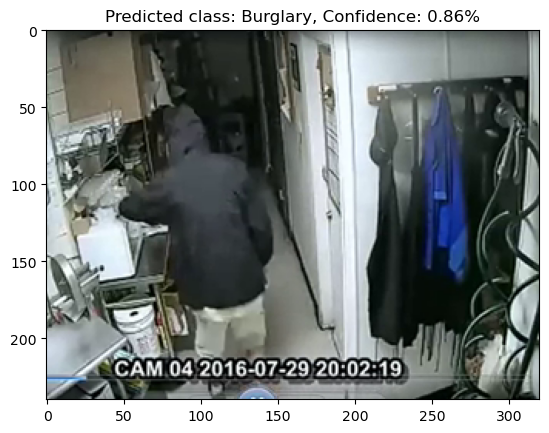

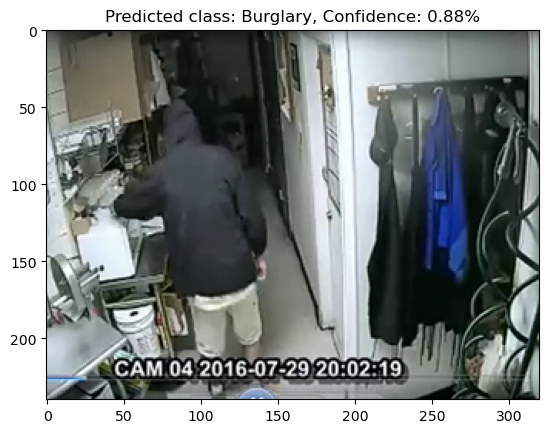

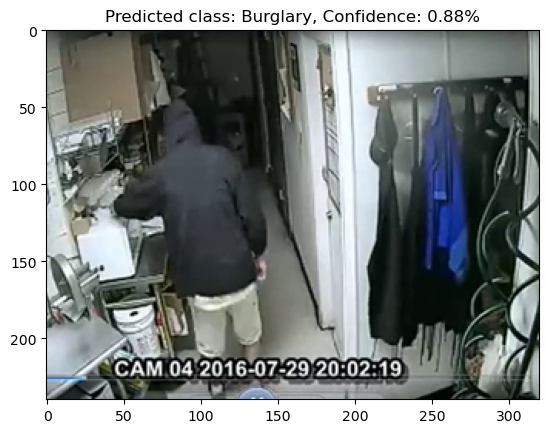

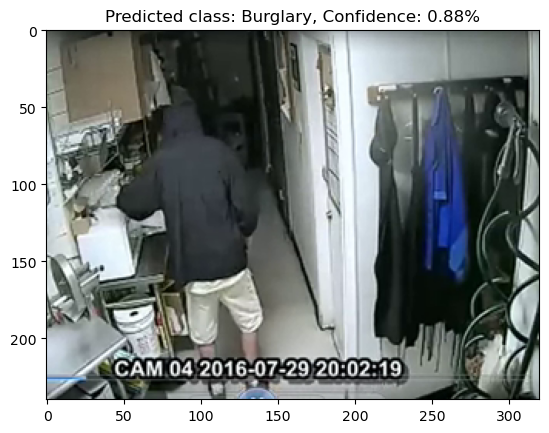

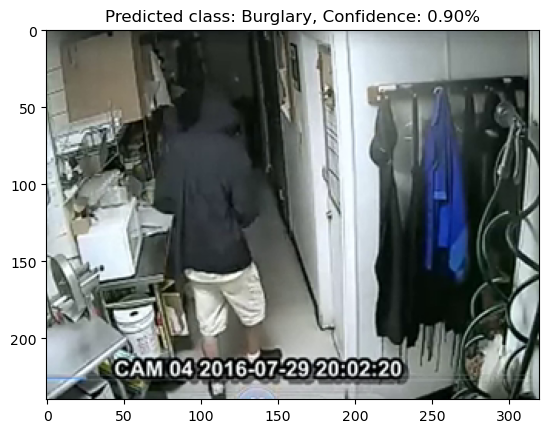

...

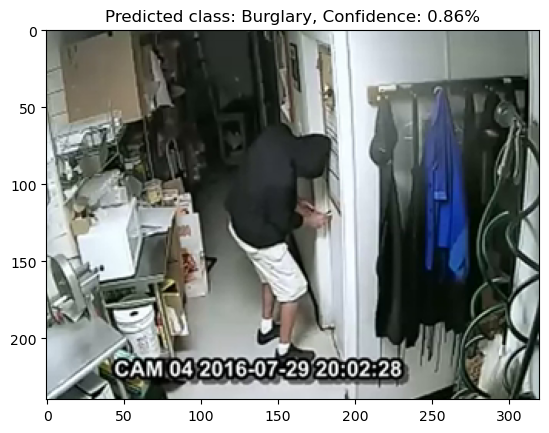

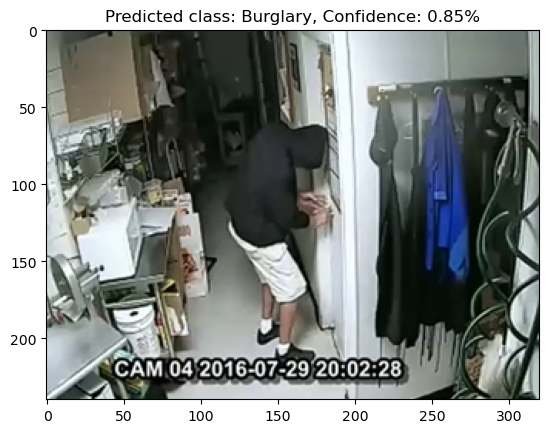

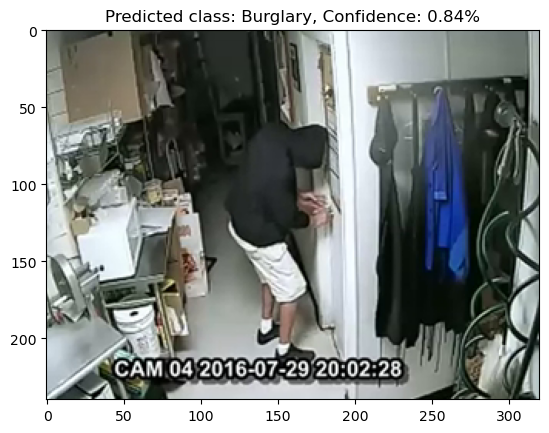

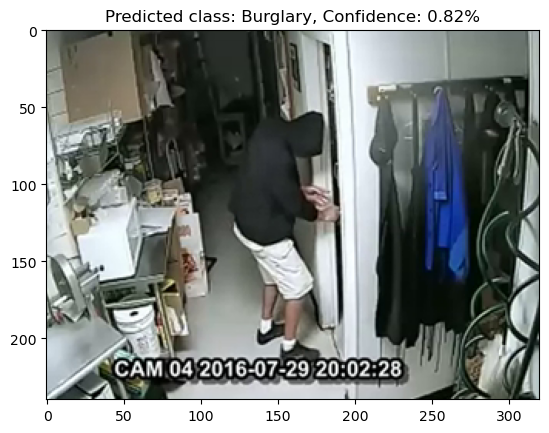

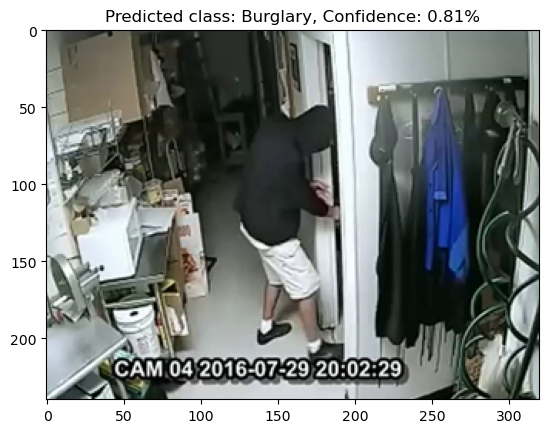

In [1]:
!pip install git+https://github.com/openai/CLIP.git
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2
import matplotlib.pyplot as plt

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given image
def get_predictions_for_frame(frame):
    # Prepare the inputs
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(1)

    # Return the top prediction
    return values[0].item(), classes[indices[0]]

# Function to process a video
def process_video(video_path, confidence_threshold=0.80):
    cap = cv2.VideoCapture(video_path)

    frame_count = 0

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_count += 1

        # Skip frames until the 5th frame
        if frame_count % 5 != 0:
            continue

        # Get predictions for the current frame
        confidence, predicted_class = get_predictions_for_frame(frame)

        # Check if the confidence exceeds the threshold
        if confidence > confidence_threshold:
            # Display the frame using matplotlib
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Predicted class: {predicted_class}, Confidence: {confidence:.2f}%")
            plt.show()

    cap.release()

# Specify the path to your video file
video_path = '/kaggle/input/ucfcrimeminidataset/dataset/Burglary/Burglary059_x264.mp4'

# Process the video
process_video(video_path)


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-56vyyy66
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-56vyyy66
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done


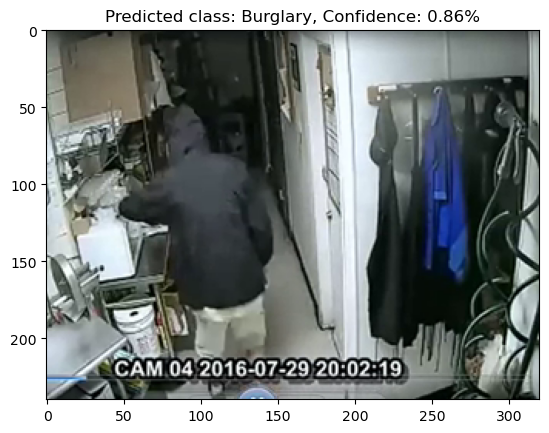

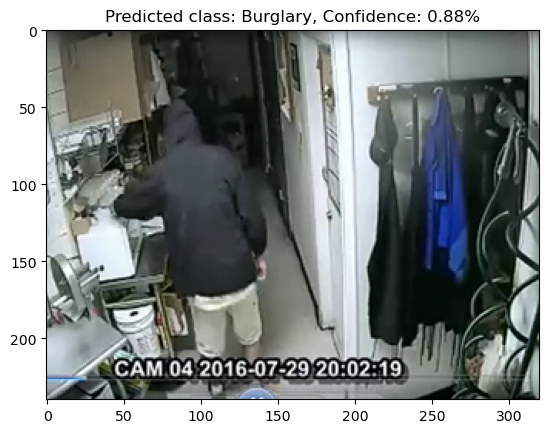

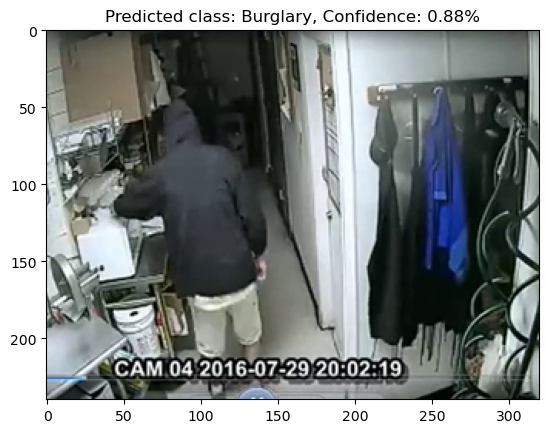

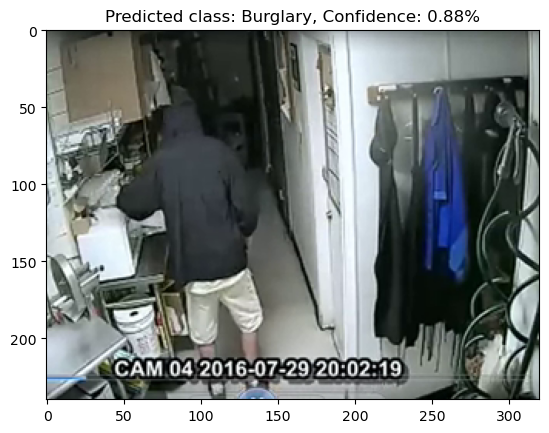

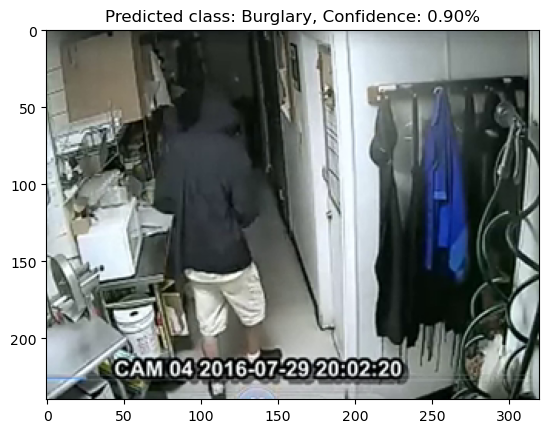

...

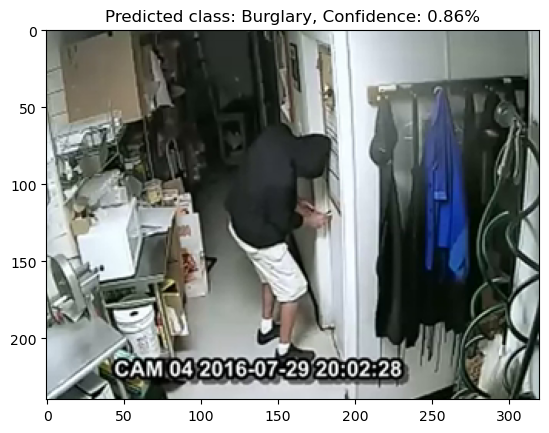

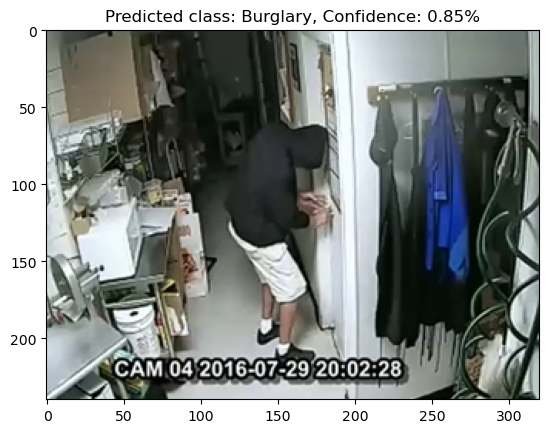

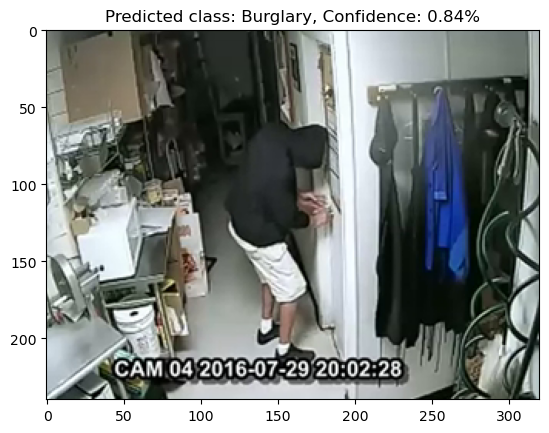

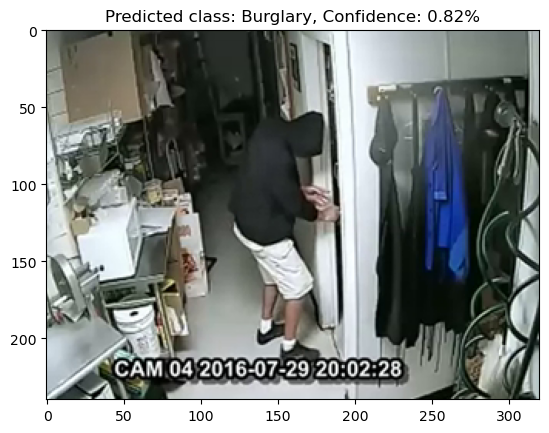

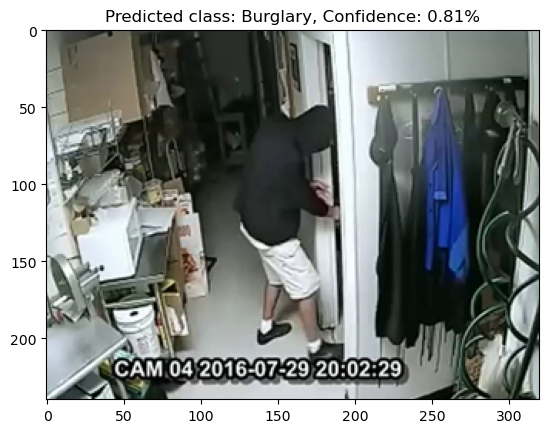

In [2]:
!pip install git+https://github.com/openai/CLIP.git
import os
import clip
import torch
from torchvision.datasets import CIFAR100
from torchvision import transforms
from PIL import Image
import cv2
import matplotlib.pyplot as plt

# Load the CLIP model and set up the device
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load('ViT-B/32', device)

# Set the path to the folder containing the classes (labels)
folder_path = "/kaggle/input/ucf-crime-dataset/Test"
classes = os.listdir(folder_path)

# Function to get predictions for a given image
def get_predictions_for_frame(frame):
    # Prepare the inputs
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    image_input = preprocess(image).unsqueeze(0).to(device)

    text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in classes]).to(device)

    # Calculate features
    with torch.no_grad():
        image_features = model.encode_image(image_input)
        text_features = model.encode_text(text_inputs)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Calculate similarity and get top predictions
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(1)

    # Return the top prediction
    return values[0].item(), classes[indices[0]]

# Function to process a video
def process_video(video_path, confidence_threshold=0.80, output_filename='output_video.mp4'):
    cap = cv2.VideoCapture(video_path)

    frame_count = 0
    frames_to_save = []

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_count += 1

        # Skip frames until the 5th frame
        if frame_count % 5 != 0:
            continue

        # Get predictions for the current frame
        confidence, predicted_class = get_predictions_for_frame(frame)

        # Check if the confidence exceeds the threshold
        if confidence > confidence_threshold:
            # Save the frame to the list
            frames_to_save.append(frame)

            # Display the frame using matplotlib
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Predicted class: {predicted_class}, Confidence: {confidence:.2f}%")
            plt.show()

    cap.release()

    # Save frames to an output video file
    height, width, _ = frames_to_save[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_filename, fourcc, 5.0, (width, height))

    for frame_to_save in frames_to_save:
        out.write(frame_to_save)

    out.release()

# Specify the path to your video file
video_path = '/kaggle/input/ucfcrimeminidataset/dataset/Burglary/Burglary059_x264.mp4'

# Specify the output filename for the saved video
output_filename = 'output_video.mp4'

# Process the video and save frames
process_video(video_path, output_filename=output_filename)
